In [195]:
import matplotlib.pyplot as plt
import numpy as np
import os
from IPython.display import Audio
#from sklearn.preprocessing import MinMaxScaler
#from sklearn.decomposition import PCA
from scipy.signal import spectrogram
from scipy.io import wavfile

In [196]:
from numpy import pi, e, sin, cos

In [4]:
frequency, signal = wavfile.read('wave/Bird On A Wire.wav')
Audio(signal[:, 0], rate=frequency)

In [5]:
def plot_spectrum(file, start=0, stop=15):
    '''
    \n\n
    file - full path to wave file
    start/stop - slice of the sound to be displayed in seconds
    Default slice is a 15 seconds from the beginning of the sound file
    \n\n
    '''
    frequency, signal = wavfile.read(file)
    
    plt.figure(figsize=(16,10))
    plt.style.use('seaborn-whitegrid')
    
    plt.subplot(211)
    plt.plot(signal[frequency*start:frequency*stop, 0], lw=0.5, c='#2196f3')
    plt.tick_params(direction='out', length=6, color='#a0a0a0', width=1, grid_alpha=.3)
    plt.ylabel('Amplitude', fontSize=12)
    plt.xlabel('Samples', fontSize=12)
    plt.title('Wave', fontSize=15, pad=9)
    
    plt.subplot(212)
    plt.subplots_adjust(hspace=0.4)
    spectrum, freqs, t, im = plt.specgram(signal[frequency*start:frequency*stop, 0], Fs=frequency, cmap='viridis')
    plt.xlabel('Time (sec)', fontSize=12)
    plt.ylabel('Frequency', fontSize=12)
    plt.title('Spectrogram', fontSize=15, pad=9)
    plt.tick_params(direction='out', length=6, color='#a0a0a0', width=1, grid_alpha=.3)
    plt.show()
    
    return spectrum, freqs, t

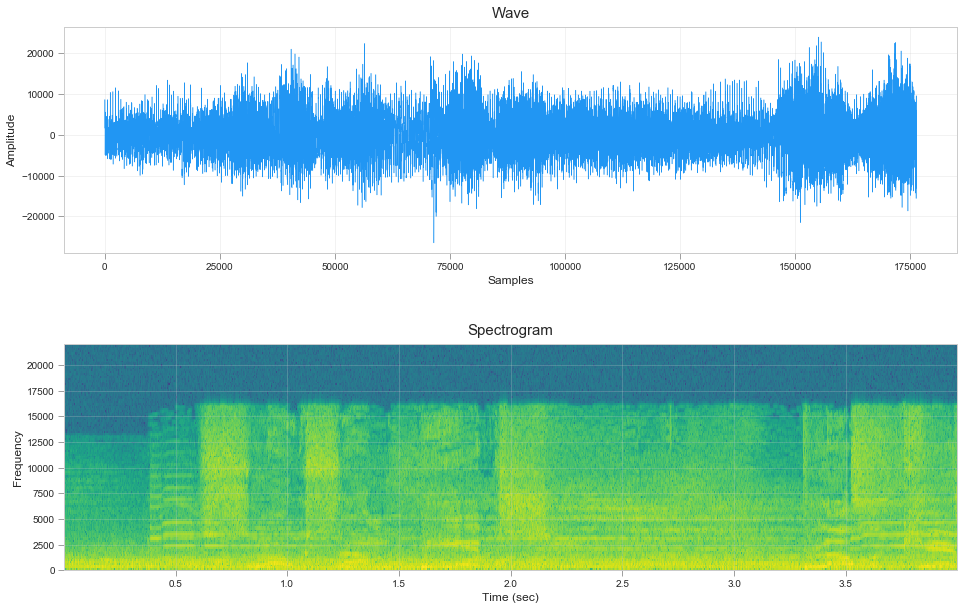

In [6]:
spectrum, freqs, t = plot_spectrum('wave/Bird On A Wire.wav', 10, 14)

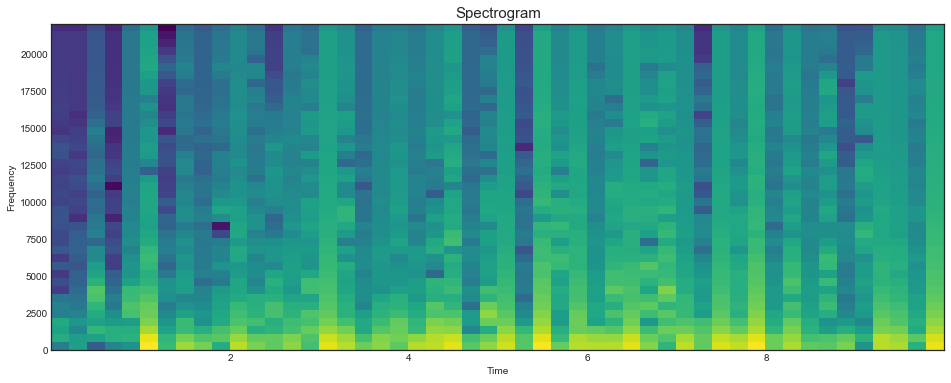

In [7]:
frequency, signal = wavfile.read('wave/Music Sounds Better With You.wav')
plt.style.use('seaborn-white')
plt.figure(figsize=(16,6))
spectrum, freqs, t, im = plt.specgram(signal[frequency*30:frequency*40, 0], NFFT=8940, pad_to=80, Fs=44100, cmap='viridis')
#for i in range(50):
#    plt.plot(np.linspace(0, 10, 50)[i], freqs[spectrum[:,i].argmax()], '*', c='w', markersize=5)
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.title('Spectrogram', fontSize=15)
plt.show()

## Discrete Fourier Transformation

# $$ {X_k} = \sum_{n=0}^N x_n \cdot e^{-\frac{j2 \pi kn} N} $$

In [8]:
def fix_xticks(time, rate):
    
    if time >= 30:
        f = np.arange(0, time*rate + rate, rate*5, dtype=int)
        t = np.array(f * (1/rate), dtype=int)
        
    elif (time > 3):
        f = np.arange(0, time*rate + (rate/4), rate, dtype=int)
        t = np.array(f * (1/rate), dtype=int)
        
    elif time <= 3:
        f = np.arange(0, time*rate + (rate/4), rate/4, dtype=int)
        t = f * (1/rate)
    
    return list(f), list(t) 

In [201]:
def generate_fading_sine(frequency, time, sample_rate, fading_rate=10):
    fade = [np.exp(i) for i in np.linspace(fading_rate, 2, sample_rate * time)]
    return np.sin(list(np.linspace(0, 2*np.pi*frequency, sample_rate)) * time) * fade


def generate_sine(frequency, time, sample_rate):
    wave = list(np.sin(np.linspace(0, 2 * pi * frequency, sample_rate)) ) * time
    #for i in range(time):
    #    wave += wave[1:]
    return wave

In [330]:
signal = generate_sine(100, 30, 1024)

In [340]:
def DFT_slow(x):
    """Compute the discrete Fourier Transform of the 1D array x"""
    x = np.asarray(x, dtype=float) # signal
    N = x.shape[0] # length
    n = np.arange(N) # indexes
    k = n.reshape((N, 1))
    M = np.exp(-2j * np.pi * k * n / N)
    return np.dot(M, x)
    #result = np.dot(M, x)
    #return 2/len(result) * np.abs(result[:len(result)//2])

def FFT(x):
    x = np.asarray(x, dtype=float)
    N = x.shape[0]
    
    if N % 2 > 0:
        raise ValueError("size of x must be a power of 2")
    
    elif N > 32:
        X_even = FFT(x[::2])
        X_odd  = FFT(x[1::2])
        factor = np.exp(-2j * np.pi * np.arange(N) / N)
        return np.concatenate([X_even + factor[: int(N/2)] * X_odd, X_even + factor[int(N/2) :] * X_odd])        
    
    else:
        return DFT_slow(x)

In [341]:
FFT(signal)

array([ 1.57562852e-12+0.00000000e+00j,  1.77052305e-14+1.62697140e-14j,
       -3.25757666e-16+1.13654181e-14j, ...,
       -1.46791067e-14-1.59425751e-14j,  5.43313884e-15-2.62117910e-14j,
        1.65388890e-14-3.33011636e-14j])

In [335]:
np_fft = np.fft.fft(signal)

np_fft1 = 2/len(np_fft) * np.abs(np_fft[:len(np_fft)//2])
np_fft2 = np.abs(np_fft[:len(np_fft)//2])

In [336]:
np.allclose(np_fft1, np_fft2)

False

In [337]:
len(np_fft1), len(np_fft2)

(15360, 15360)

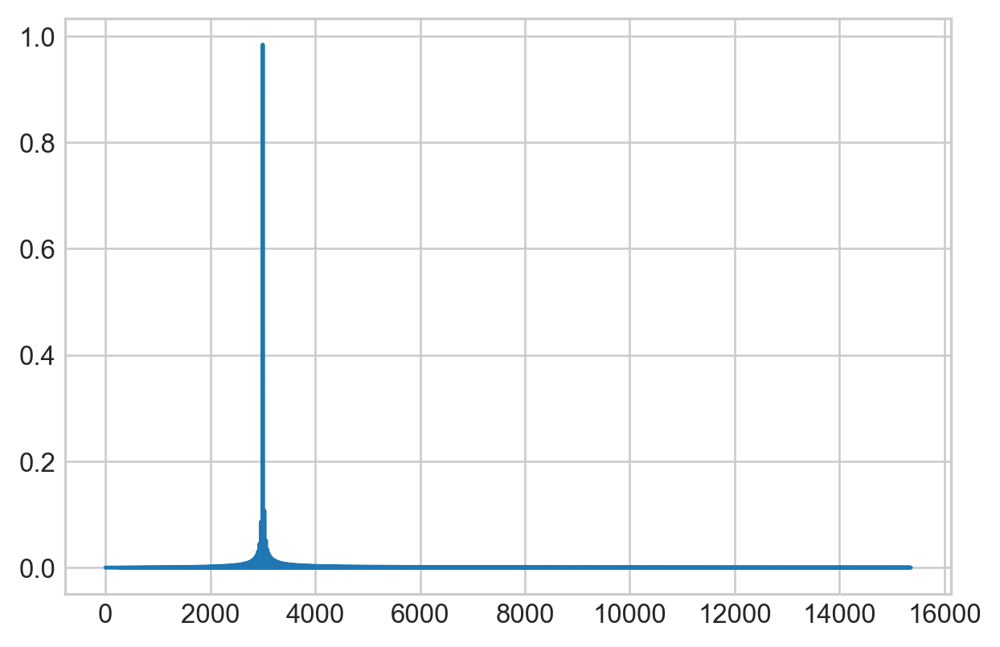

In [334]:
np_fft = np.fft.fft(signal)
np_fft = 2/len(np_fft) * np.abs(np_fft[:len(np_fft)//2])

plt.plot(np_fft)

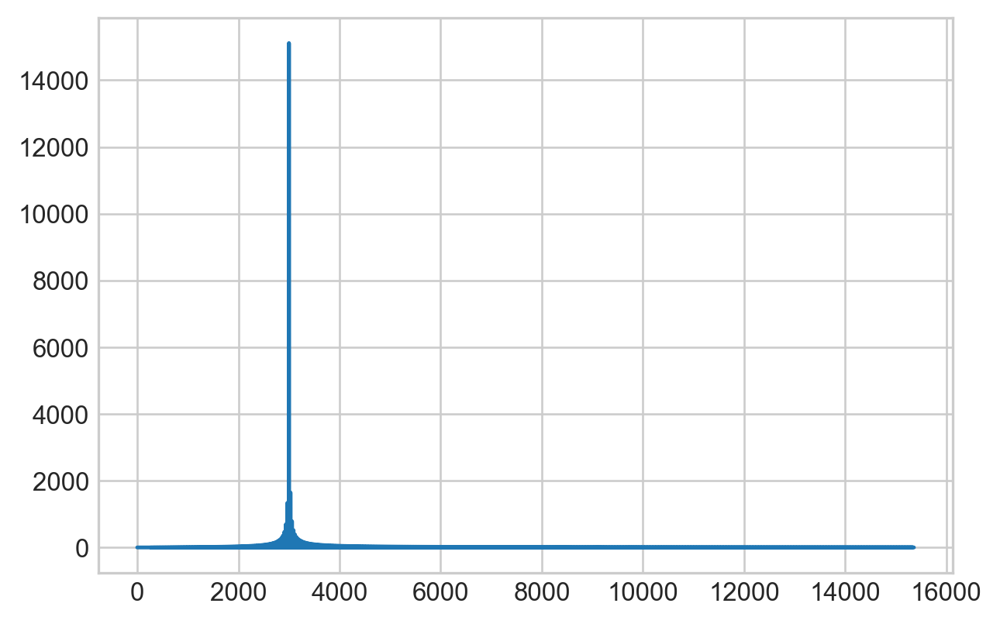

In [332]:
np_fft = np.fft.fft(signal)
np_fft = 2/len(np_fft) * np.abs(np_fft[:len(np_fft)//2])

plt.plot(np_fft)

In [333]:
sample_rate = 400
time = 4

s, t = fix_xticks(time, sample_rate)

signal = generate_sine(50, time, sample_rate)


plt.figure(figsize=(16,4))
plt.plot(signal, label='Signal')
plt.plot(signal[:sample_rate], lw=3, label='400 beats')
plt.axvline(0, ls='--', c='gray')
plt.axvline(400, ls='--', c='gray')
plt.xticks(s, t)

plt.legend(frameon=True, loc=(0.88, 0.76), borderpad=.8, framealpha=0.9)
plt.tick_params(direction='out', length=6, color='#a0a0a0', width=1, grid_alpha=.6)
plt.title('Signal', fontSize=15)
plt.ylabel('Amplitude', fontSize=12)
plt.xlabel('Time (in seconds)', fontSize=12)
plt.show()

NameError: name 'fix_xticks' is not defined

In [380]:
Audio(signal, rate=sample_rate)

## Magnitudes

In [400]:
fft_original = DFT_slow(signal)

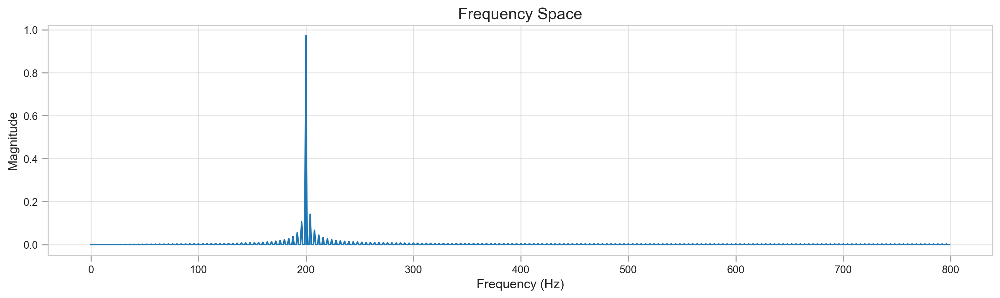

In [401]:
plt.figure(figsize=(16,4))
plt.rcParams['figure.dpi'] = 227
plt.style.use('seaborn-whitegrid')


fft_pretty = 2/len(fft_original) * np.abs(fft_original[:len(fft_original)//2])

plt.plot(fft_pretty)
plt.tick_params(direction='out', length=6, color='#a0a0a0', width=1, grid_alpha=.6)
plt.title('Frequency Space', fontSize=15)
plt.ylabel('Magnitude', fontSize=12)
plt.xlabel('Frequency (Hz)', fontSize=12)
plt.show()

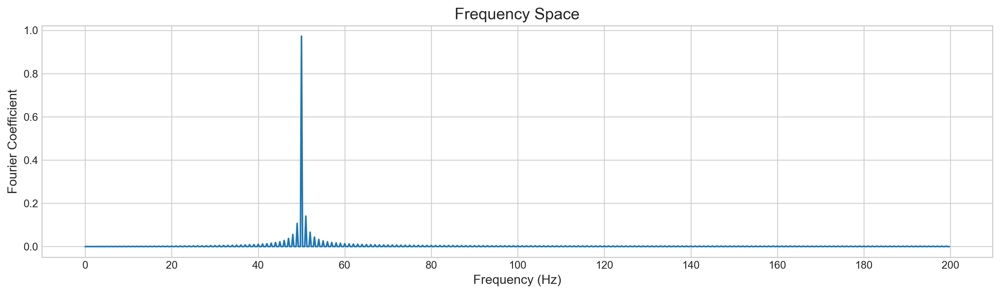

In [402]:
x_ticks = np.linspace(0, len(fft_pretty), 11)
x_labels = np.array(x_ticks * sample_rate / len(signal), dtype='int')

plt.figure(figsize=(16, 4))
plt.plot(fft_pretty)
plt.xticks(x_ticks, x_labels)
plt.title("Frequency Space", fontSize=15)
plt.xlabel("Frequency (Hz)", fontSize=12)
plt.ylabel("Fourier Coefficient", fontSize=12)
plt.show()

In [405]:
def get_xn(Xs,n):
    L  = len(Xs)
    ks = np.arange(0,L,1)
    xn = np.sum(Xs*np.exp((1j*2*np.pi*ks*n)/L))/L
    return(xn)

def get_xns(ts):
    mag = []
    L = len(ts)
    for n in range(int(L/2)): # Nyquest Limit
        mag.append(np.abs(get_xn(ts,n))*2)
    return(mag)

In [432]:
def create_spectrogram(signal, NFFT, noverlap = None):

    if noverlap is None:
        noverlap = NFFT/2
    noverlap = int(noverlap)
    
    starts  = np.arange(0, len(signal), NFFT-noverlap, dtype=int)
    # remove any window with less than NFFT sample size
    starts  = starts[starts + NFFT < len(signal)]
    xns = []
    for start in starts:
        # short term discrete fourier transform
        #ts_window = get_xns(signal[start:start + NFFT]) 
        ts_window = DFT_slow(signal[start:start + NFFT])
        xns.append(ts_window)
        
    specX = np.array(xns).T
    # rescale the absolute value of the spectrogram as rescaling is standard
    spec = 10*np.log10(specX)
    assert spec.shape[1] == len(starts) 
    return(starts, spec)

L = 128
noverlap = None
starts, spec = create_spectrogram(signal, L, noverlap = noverlap )

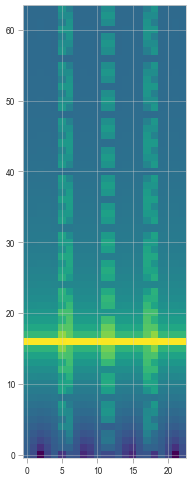

In [434]:
sample_rate = 4000
ts = signal
total_ts_sec = 2

plt.figure(figsize=(16, 10))
plt.rcParams['figure.dpi'] = 60
#plt.yticks(np.linspace(0, 64, 10), np.linspace(0, 2000, 10, dtype='int'))
#plt.xticks(np.linspace(0, 370, 11), np.arange(0, 11, 1))
plt.imshow(spec, origin='lower', cmap='viridis', interpolation='nearest')
plt.tick_params(direction='out', length=6, color='#a0a0a0', width=1, grid_alpha=.6)
plt.show()

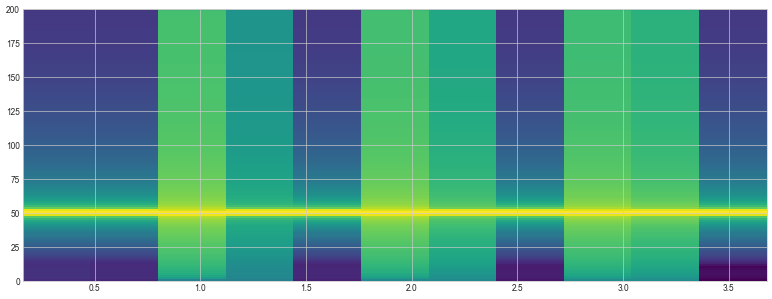

In [426]:
plt.figure(figsize=(16,6))
spectrum, freqs, t, im = plt.specgram(signal, Fs=400, cmap='viridis')
plt.show()